# Controllable GAN

In [1]:
!git clone https://github.com/amazon-science/gan-control.git

Cloning into 'gan-control'...
remote: Enumerating objects: 228, done.
remote: Counting objects: 100% (17/17), done.
remote: Compressing objects: 100% (14/14), done.
remote: Total 228 (delta 6), reused 5 (delta 3), pack-reused 211
Receiving objects: 100% (228/228), 65.54 MiB | 25.48 MiB/s, done.
Resolving deltas: 100% (46/46), done.


In [3]:
%cd /content/gan-control/resources
%mkdir gan_models
%cd gan_models
%cd /content
!gdown 19v0lX69fV6zQv2HbbYUVr9gZ8ZKvUzHq

/content/gan-control/resources
mkdir: cannot create directory ‘gan_models’: File exists
/content/gan-control/resources/gan_models
/content
Downloading...
From: https://drive.google.com/uc?id=19v0lX69fV6zQv2HbbYUVr9gZ8ZKvUzHq
To: /content/controller_age015id025exp02hai04ori02gam15.tar.gz
100% 824M/824M [00:12<00:00, 65.9MB/s]


In [4]:
# Link for dowload GAN models = https://drive.google.com/file/d/19v0lX69fV6zQv2HbbYUVr9gZ8ZKvUzHq/view?usp=sharing
# Import the model
!tar -xzvf "/content/controller_age015id025exp02hai04ori02gam15.tar.gz" -C "/content/gan-control/resources/gan_models/"

._controller_age015id025exp02hai04ori02gam15_temp
controller_age015id025exp02hai04ori02gam15_temp/
controller_age015id025exp02hai04ori02gam15_temp/._.DS_Store
controller_age015id025exp02hai04ori02gam15_temp/.DS_Store
controller_age015id025exp02hai04ori02gam15_temp/._orientation_loss_20201013-094838
controller_age015id025exp02hai04ori02gam15_temp/orientation_loss_20201013-094838/
controller_age015id025exp02hai04ori02gam15_temp/._age_loss_20201013-061438
controller_age015id025exp02hai04ori02gam15_temp/age_loss_20201013-061438/
controller_age015id025exp02hai04ori02gam15_temp/._expression_q_loss_20201013-151038
controller_age015id025exp02hai04ori02gam15_temp/expression_q_loss_20201013-151038/
controller_age015id025exp02hai04ori02gam15_temp/._generator
controller_age015id025exp02hai04ori02gam15_temp/generator/
controller_age015id025exp02hai04ori02gam15_temp/._hair_loss_20201116-092804
controller_age015id025exp02hai04ori02gam15_temp/hair_loss_20201116-092804/
controller_age015id025exp02hai04

In [5]:
import os
import torch
from PIL import Image
import pandas as pd
import sys

sys.path.append('/content/gan-control/src')  # insert the path to src here

## Load controller

In [6]:
from gan_control.inference.controller import Controller
controller_path = '/content/gan-control/resources/gan_models/controller_age015id025exp02hai04ori02gam15_temp'
controller = Controller(controller_path)

/content/gan-control/src/gan_control/inference/controller.py:105: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  group_chunk = self.batch_utils.place_in_latent_dict[sub_group_name if sub_group_name is not 'expression_q' else 'expression']
INFO:gan_control.inference.controller: Init Controller class...
INFO:gan_control.inference.controller:Init Controller class...
INFO:gan_control.inference.inference: Init inference class...
INFO:gan_control.inference.inference:Init inference class...
INFO:gan_control.inference.inference: Retrieve config from /content/gan-control/resources/gan_models/controller_age015id025exp02hai04ori02gam15_temp/generator/args.json
INFO:gan_control.inference.inference:Retrieve config from /content/gan-control/resources/gan_models/controller_age015id025exp02hai04ori02gam15_temp/generator/args.json
INFO:gan_control.inference.inference: Init Batch Utils...
INFO:gan_control.inference.inference:Init Batch Utils...
INFO:gan_control.utils.mini_batch_multi_split

# Features control

## Generate random faces and save latents

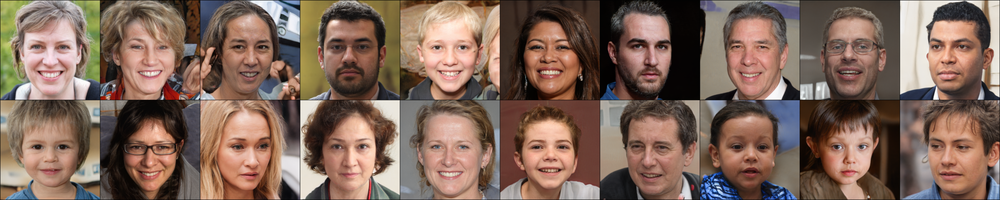

In [13]:
batch_size = 20
truncation = 0.7
resize = 480
initial_image_tensors, initial_latent_z, initial_latent_w = controller.gen_batch(batch_size=batch_size, truncation=truncation)
controller.make_resized_grid_image(initial_image_tensors, resize=resize, nrow=10)

## Control age
Control parameter: Age (scalar)

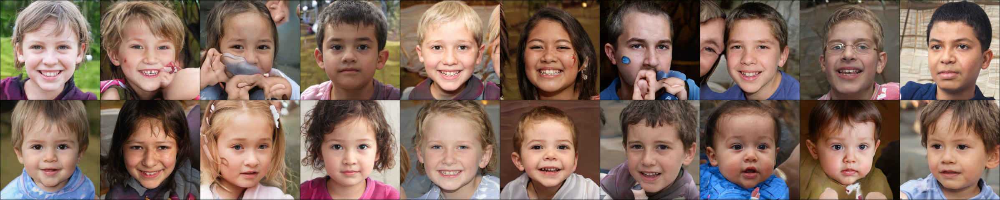

In [18]:
# age = 10
age_control = torch.tensor([[10.]])
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=initial_latent_w, input_is_latent=True, age=age_control)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=10)

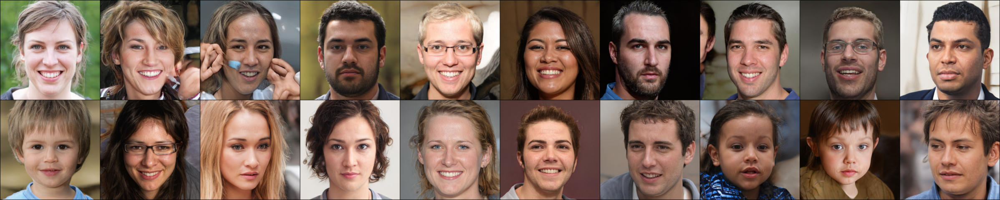

In [21]:
# age = 30
age_control = torch.tensor([[30.]])
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, age=age_control)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=10)

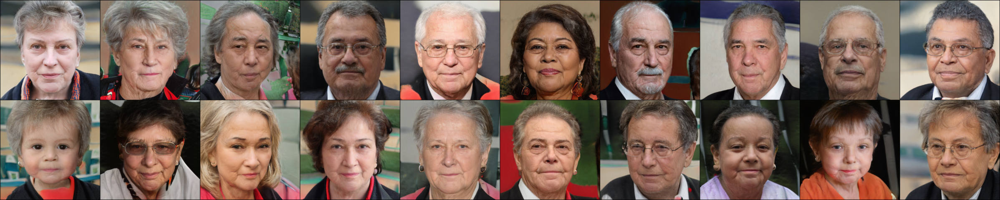

In [117]:
# age = 80
age_control = torch.tensor([[80.]])
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, age=age_control)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=10)

## Control hair color
Control parameter: RGB hair color (R, G, B)

In [50]:
brown_color = torch.tensor([[0.47 , 0.33 , 0.23]])
gray_color = torch.tensor([[0.7 , 0.7 , 0.7]])
black_color = torch.tensor([[0.07 , 0.07 , 0.07]])

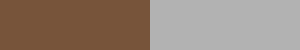

In [51]:
def get_concat_h(im1, im2):
    dst = Image.new('RGB', (im1.width + im2.width, im1.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    return dst

brown_img = Image.new('RGB', (150, 50), tuple((brown_color * 255).int().tolist()[0]))
gray_img = Image.new('RGB', (150, 50), tuple((gray_color * 255).int().tolist()[0]))
black_img = Image.new('RGB', (150, 50), tuple((black_color * 255).int().tolist()[0]))
get_concat_h(brown_img, gray_img)

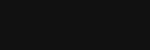

In [52]:
black_img

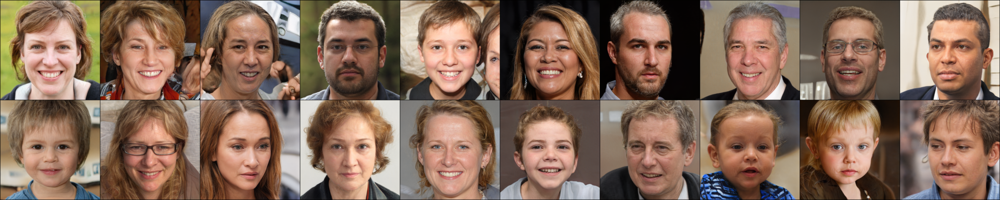

In [39]:
# brown
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=initial_latent_w, input_is_latent=True, hair=brown_color)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=10)

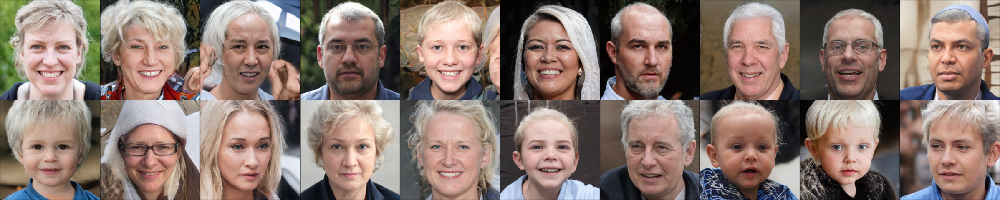

In [40]:
# gray
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=initial_latent_w, input_is_latent=True, hair=gray_color)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=10)

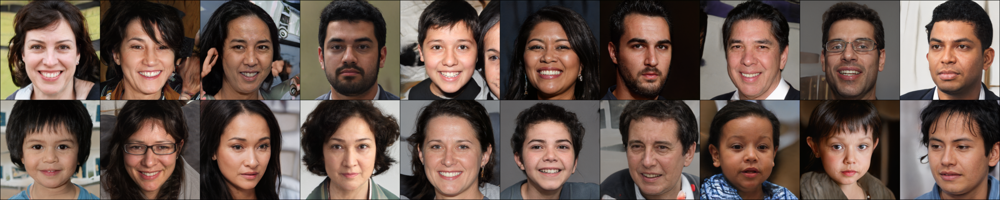

In [54]:
# black
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, hair=black_color)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=10)

## Control expression
Control parameter: 3DMM beta paramter (64 dimensions)

In [111]:
# Loading extracted attributes df
attributes_df = pd.read_pickle('/content/gan-control/resources/ffhq_1K_attributes_samples_df.pkl')
expressions = attributes_df.expression3d.to_list()

# Some chosen expressions (most expression are smilles)
yuck = torch.tensor([expressions[18]])
smile = torch.tensor([expressions[50]])
no_emotion = torch.tensor([expressions[2]])


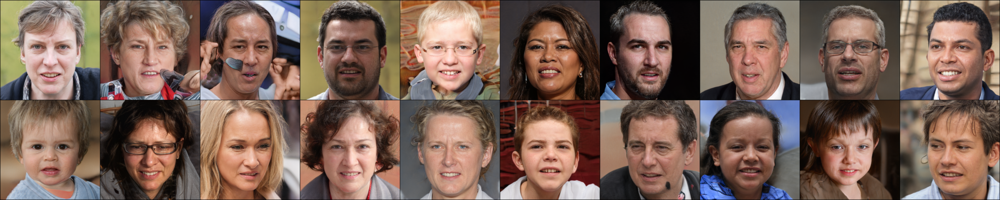

In [112]:
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=initial_latent_w, input_is_latent=True, expression=yuck)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=10)

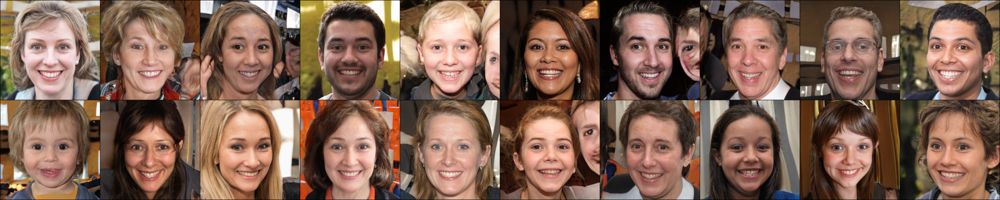

In [113]:
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, expression=smile)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=10)

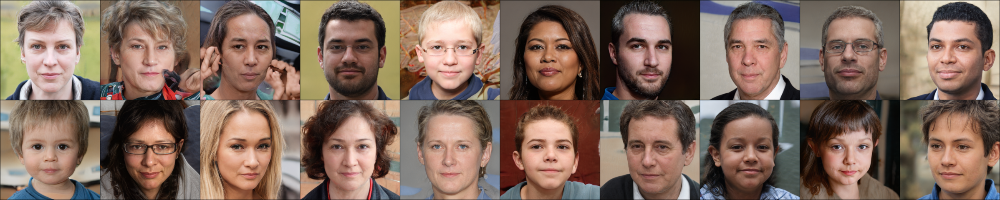

In [114]:
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, expression=no_emotion)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=10)

# Demo

In [115]:
def control_features(age, hair_color, expression_type):
  image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=initial_latent_w, input_is_latent=True,
                                                                        age=torch.tensor([[age]]),
                                                                        hair=hair_color,
                                                                        expression= expression_type)
  return controller.make_resized_grid_image(image_tensors, resize=resize, nrow=10)

### Features Option
Hair color options:
1. `black_color`
2. `gray_color`
3. `brown_color`

PS. or you can use rgb as in example below

Expression options:
1. `yuck`
2. `smile`
3. `no_emotion`

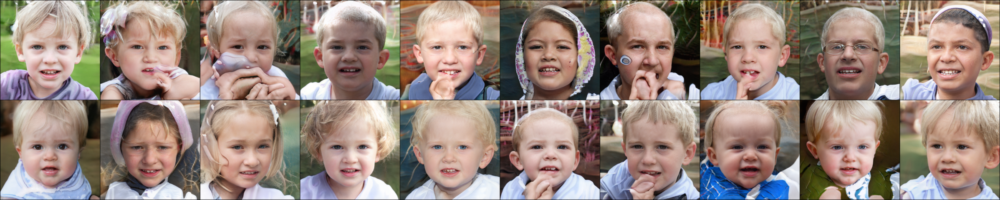

In [120]:
# set controllable features
age = 10
hair_color = torch.tensor([[0.7 , 0.7 , 0.7]])
expression_type = yuck

control_features(age, hair_color, expression_type)